In [1]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import copy

In [2]:
#initial conditions 
# theta_01 = 1e-1
# theta_02 = 1e-3
# theta_03 = 1e-6
# theta_dash_0 = 0
k = 4e-4
# t_rk = [0]
# tau  = 0.1


$$\ddot{\theta}= k\sin{\theta}$$

In [3]:
def driven_pendulum(x_initial,v_initial,tau_here,time_steps):
    t_pen=[0]
    v_pen=[v_initial]
    x_pen=[x_initial]
    tau=tau_here
    for i in range(1,time_steps):
        t_pen.append(tau*i)
        k1=tau*v_pen[i-1]
        l1=tau*(k*np.sin(x_pen[i-1]))
        k2=tau*(v_pen[i-1]+0.5*l1)
        l2=tau*(k*np.sin(x_pen[i-1]+0.5*k1))
        k3=tau*(v_pen[i-1]+0.5*l2)
        l3=tau*(k*np.sin(x_pen[i-1]+0.5*k2))
        k4=tau*(v_pen[i-1]+l3)
        l4=tau*(k*np.sin(x_pen[i-1]+k3))
        xnew=x_pen[i-1]+(1/6)*(k1+2*k2+2*k3+k4)
        if xnew>np.pi/2:
            xnew=xnew-2*np.pi
        if xnew<-np.pi/2:
            xnew=xnew+2*np.pi
        x_pen.append(xnew)
        v_pen.append(v_pen[i-1]+(1/6)*(l1+2*l2+2*l3+l4))
    return t_pen,v_pen,x_pen

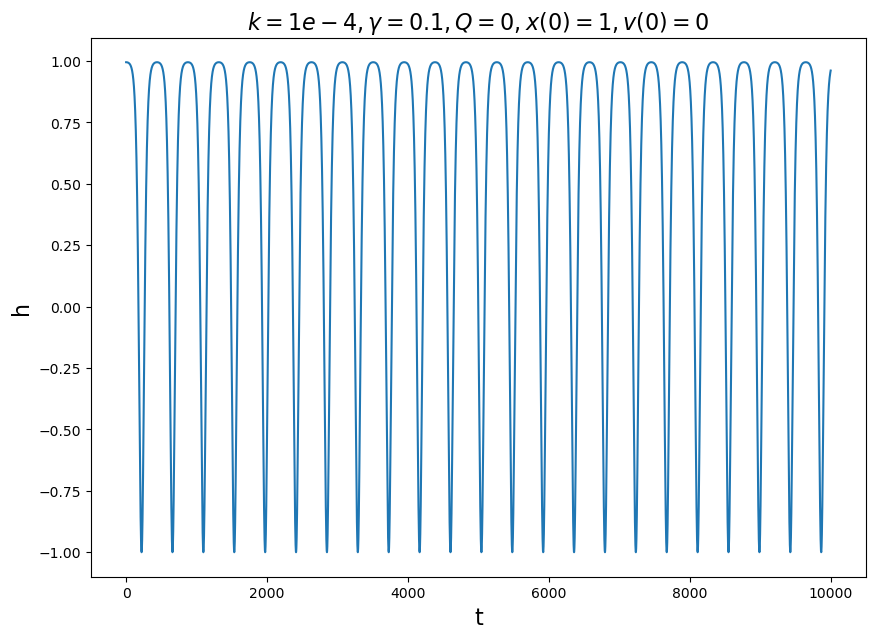

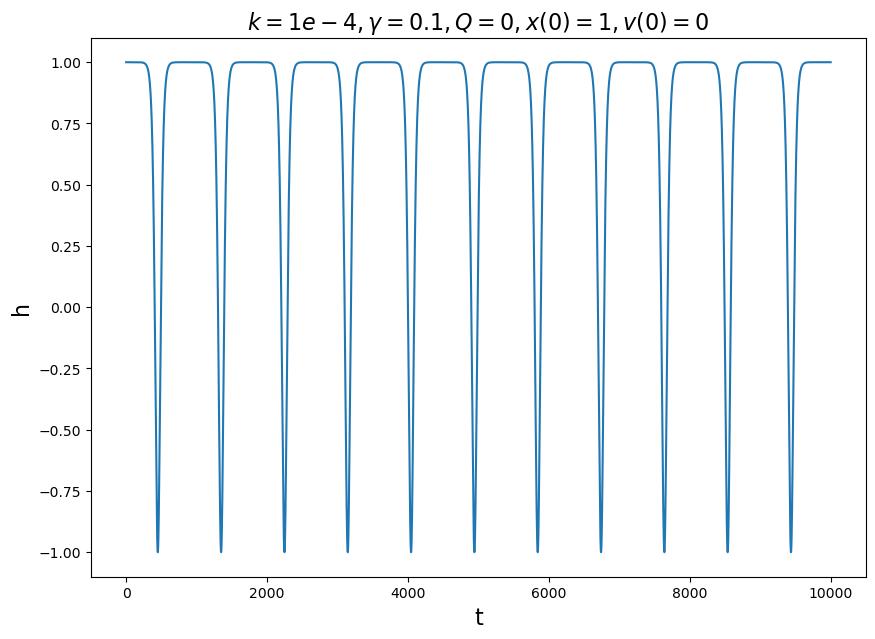

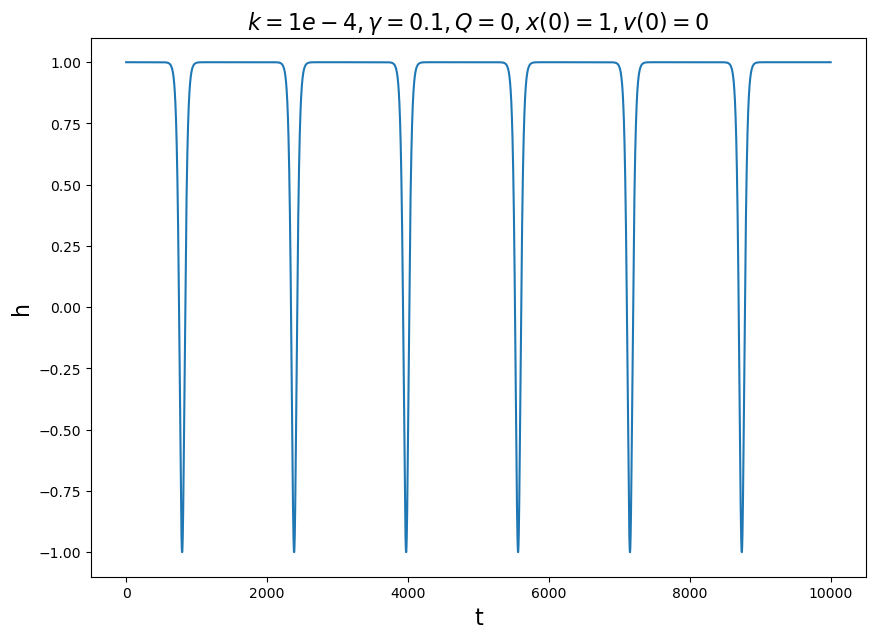

In [4]:
x_initial_list = [1e-1, 1e-3, 1e-6]
for x_initial in x_initial_list:
    t_list,v_list,x_list=driven_pendulum(x_initial=x_initial,v_initial=0,tau_here=0.1,time_steps=100000)
    # convert the x into h by h = cos(x) but only include pi/2 to -pi/2
    h_list = np.cos(x_list)
    plt.figure(figsize=(10,7))
    plt.plot(t_list,h_list)
    plt.xlabel('t',size=16)
    plt.ylabel('h',size=16)
    plt.title('$k=1e-4, \gamma=0.1, Q=0, x(0)=1, v(0)=0$',size=16)

# explanation
Since the height of the pendulum looks the same for every period. It does not exibit any chaotic behavior. It is a soliton.

In [5]:
#Q2
epsilon = 1e-4
h = 1
epsilon_0 = 1
d = 2



Processing n = 12


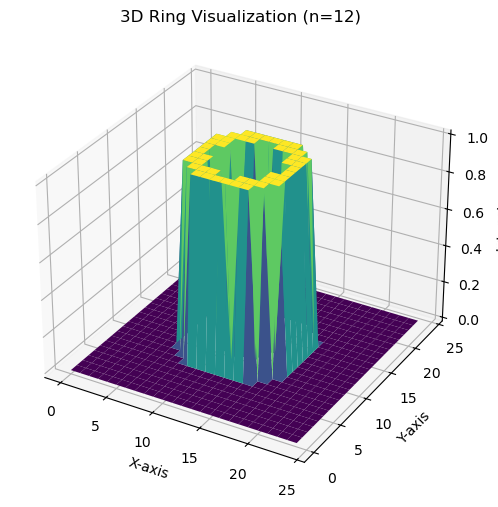

Jacobi relaxation converged in 832 iterations.


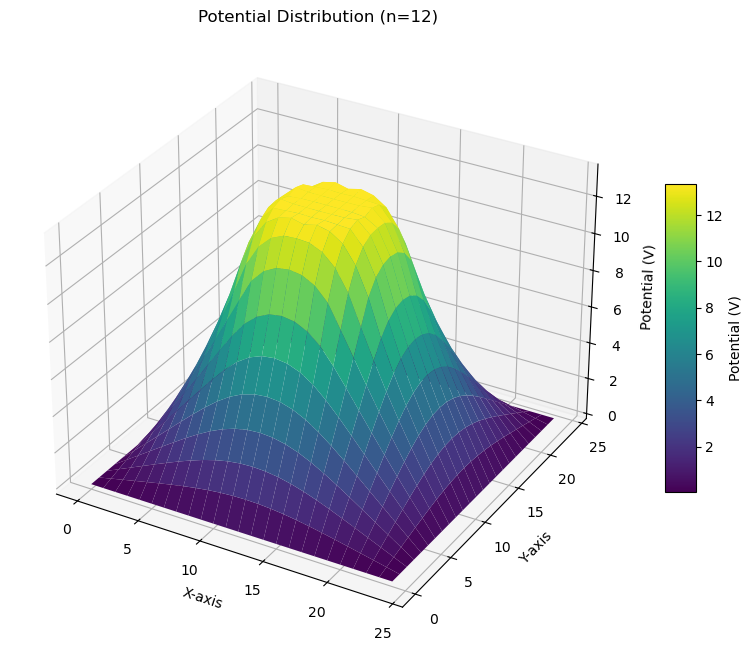

Gauss Seidel relaxation converged in 452 iterations.


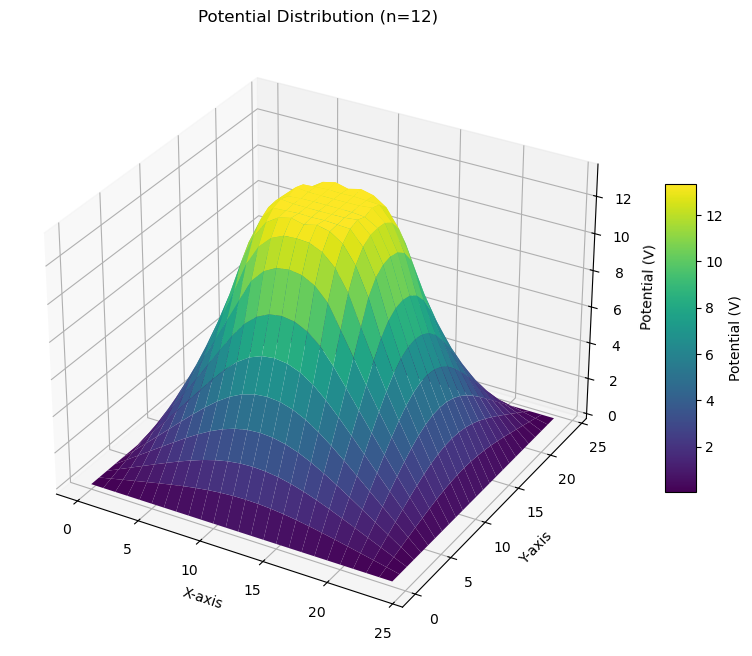

1.7603051467765594
Successive Over relaxation converged in 60 iterations.


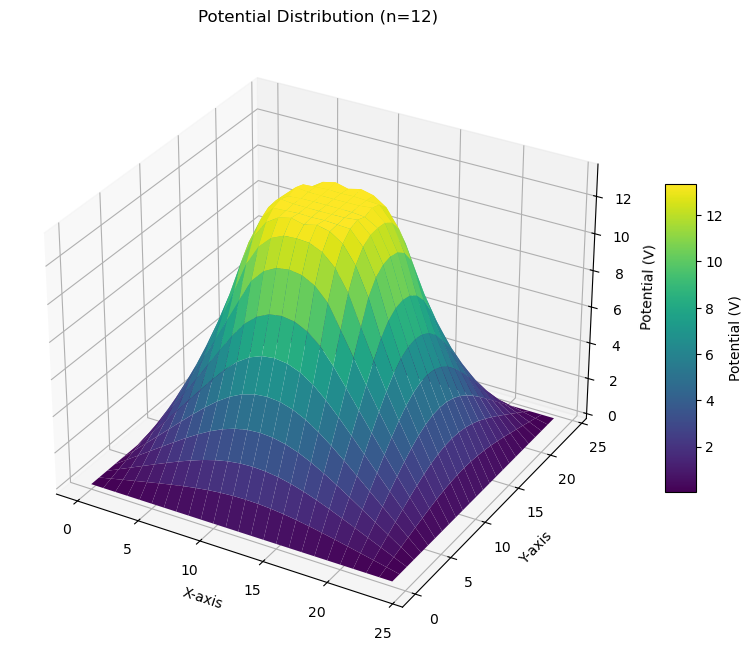


Processing n = 32


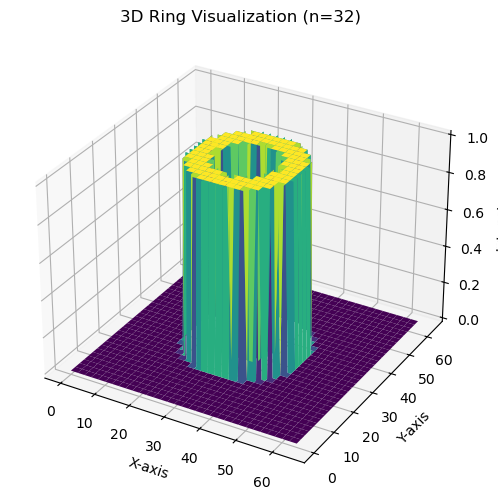

Jacobi relaxation converged in 5882 iterations.


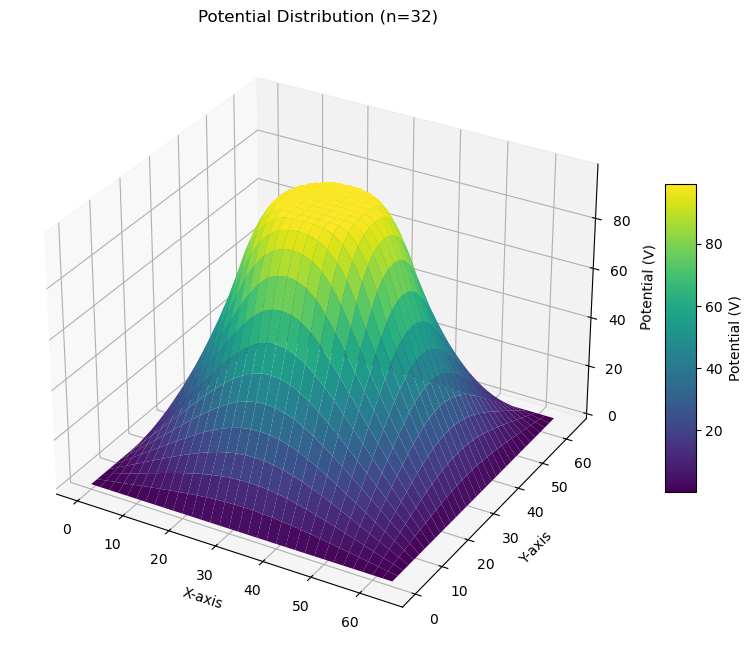

Gauss Seidel relaxation converged in 3228 iterations.


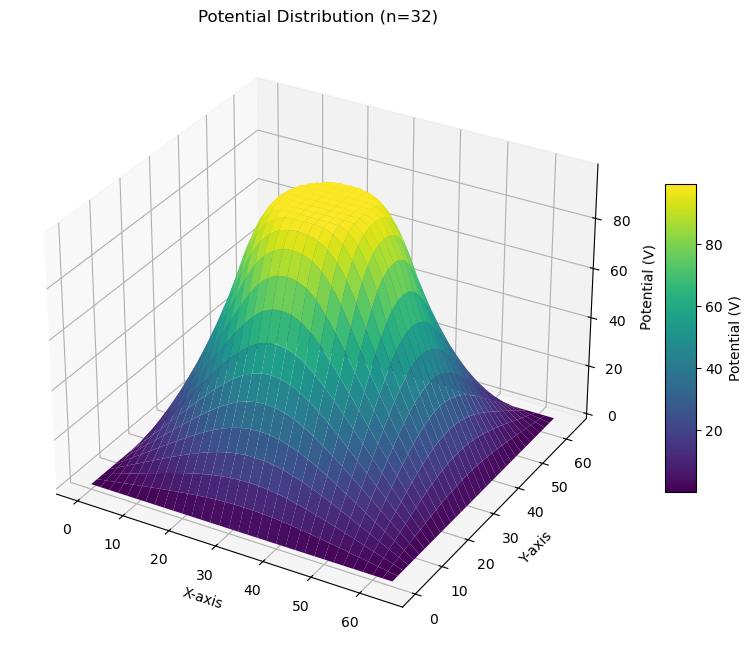

1.9050415182999392
Successive Over relaxation converged in 163 iterations.


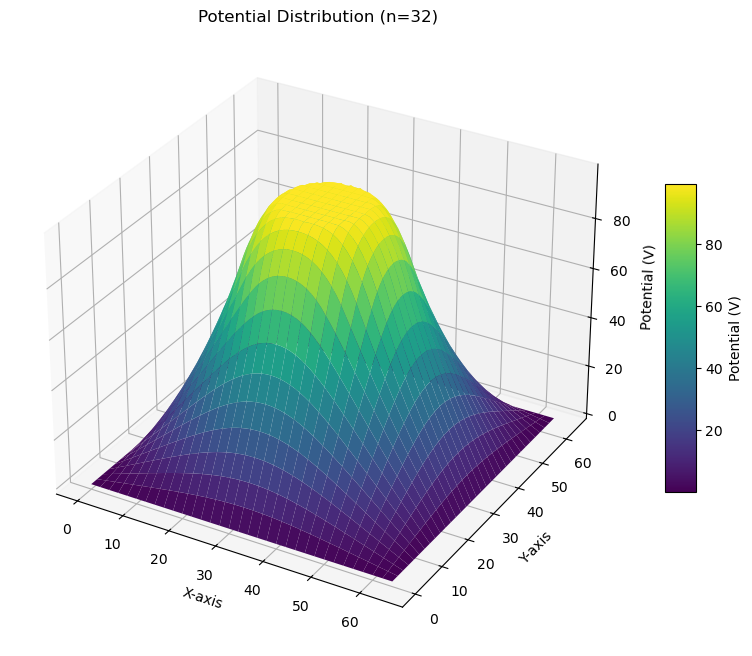


Processing n = 40


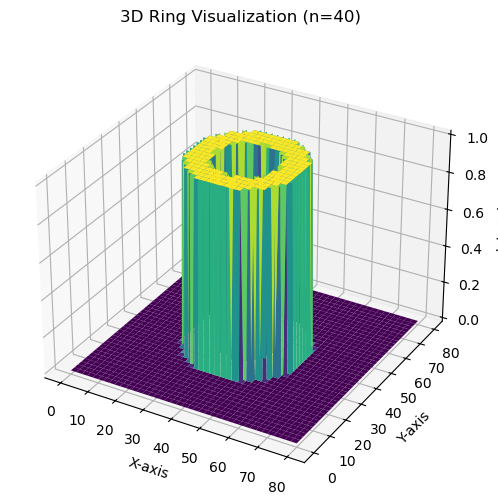

Jacobi relaxation converged in 9191 iterations.


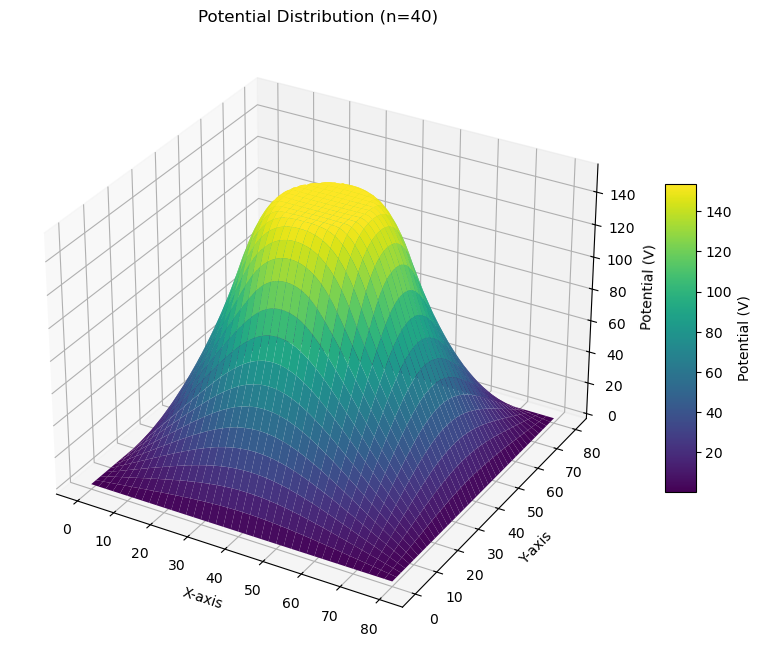

Gauss Seidel relaxation converged in 5040 iterations.


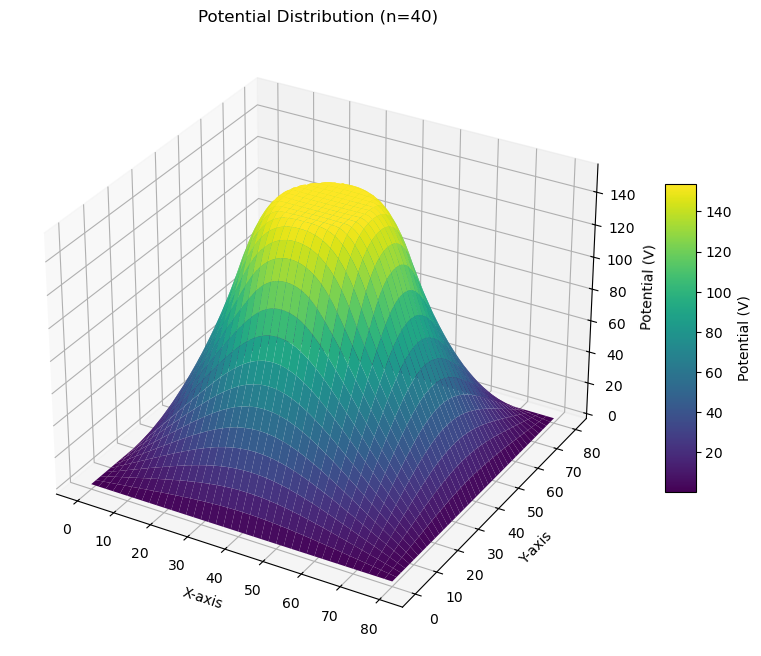

1.9235272594695507
Successive Over relaxation converged in 205 iterations.


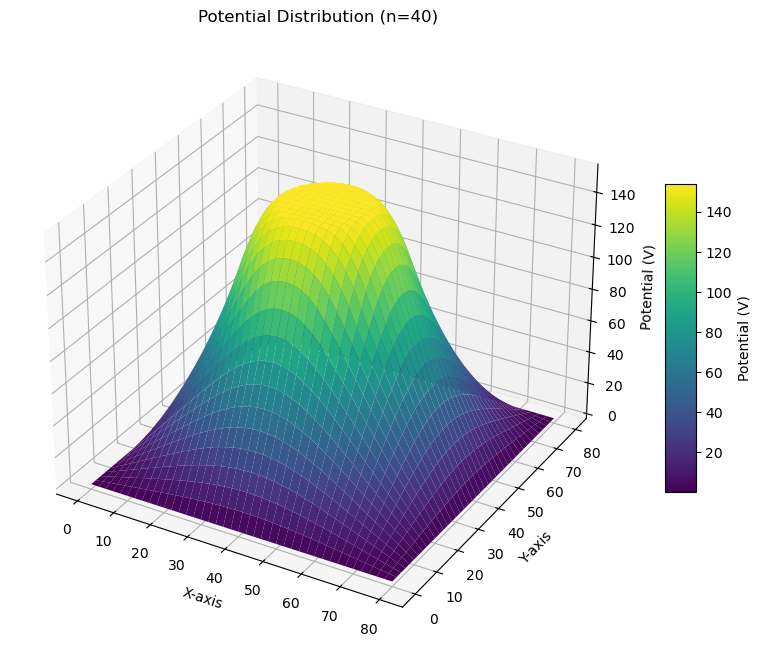

In [6]:
# this part is for Q2(a)
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  # For 3D plotting
import copy


def ring(n):
    """
    Creates a 2D ring with ones in positions where the distance from the center
    is between n/4 and n/2.

    Parameters:
    - n: Radius parameter to define the size of the ring.

    Returns:
    - arr: 2D NumPy array representing the ring.
    """
    arr = np.zeros((2 * n + 1, 2 * n + 1))
    center = n
    for i in range(2 * n + 1):
        for j in range(2 * n + 1):
            distance = np.sqrt((i - center) ** 2 + (j - center) ** 2)
            if n / 4 < distance < n / 2:
                arr[i, j] = 1
    return arr

def star_of_david(n):
    """
    Creates a 2D Star of David pattern with ones in positions forming the shape.

    Parameters:
    - n: Radius parameter to define the size of the pattern.

    Returns:
    - arr: 2D NumPy array representing the Star of David pattern.
    """
    arr = np.zeros((2 * n + 1, 2 * n + 1))
    center = n
    for i in range(2 * n + 1):
        for j in range(2 * n + 1):
            if (i - center) ** 2 + (j - center) ** 2 < n ** 2:
                arr[i, j] = 1
            elif i < center and j < center and i + j < 2 * center:
                arr[i, j] = 1
            elif i > center and j > center and i + j > 2 * center:
                arr[i, j] = 1
    return arr

def plot_ring(n):
    """
    Plots a 3D surface plot of the ring.

    Parameters:
    - n: Radius parameter used in the ring function.
    """
    fig = plt.figure(figsize=(8, 6))
    ax = fig.add_subplot(111, projection="3d")

    arr = ring(n)
    x = np.linspace(0, 2 * n, 2 * n + 1)
    y = np.linspace(0, 2 * n, 2 * n + 1)
    X, Y = np.meshgrid(x, y)

    # Only plot points where arr==1 to highlight the ring
    ax.plot_surface(X, Y, arr, cmap="viridis")

    ax.set_title(f"3D Ring Visualization (n={n})")
    ax.set_xlabel("X-axis")
    ax.set_ylabel("Y-axis")
    ax.set_zlabel("Intensity")

    plt.show()


def jacobi_relaxation(
    charge_density, size, epsilon, bound_jr=1e-4, max_iterations=100000
):
    """
    Performs Jacobi relaxation to solve for the potential distribution.

    Parameters:
    - charge_density: 2D NumPy array representing the charge distribution.
    - size: Size of the grid (assuming square grid).
    - epsilon: Permittivity constant.
    - bound_jr: Convergence threshold.
    - max_iterations: Maximum number of iterations to prevent infinite loops.

    Returns:
    - iterations: Number of iterations performed.
    - potential_new: 2D NumPy array of the computed potential.
    """
    h = 1  # Grid spacing
    d = 2  # Number of nearest neighbors (left, right, up, down)
    iterations = 0

    # Initialize potential arrays
    potential_initial = np.zeros((size, size))
    potential_here = copy.deepcopy(potential_initial)

    while iterations < max_iterations:
        iterations += 1
        potential_new = copy.deepcopy(potential_here)

        # Update potential for each non-boundary point
        for i in range(1, size - 1):
            for j in range(1, size - 1):
                # Neighbors
                left = potential_here[i - h, j]
                right = potential_here[i + h, j]
                up = potential_here[i, j + h]
                down = potential_here[i, j - h]

                # Jacobi update formula
                potential_new[i, j] = (left + right + up + down) / (2 * d) + (
                    h**2 / (2 * d * epsilon)
                ) * charge_density[i, j]

        # Compute the maximum change across the grid
        max_delta = np.max(np.abs(potential_new - potential_here))

        # Check for convergence
        if max_delta <= bound_jr:
            break
        else:
            potential_here = potential_new.copy()

    print(potential_here)

    if iterations == max_iterations:
        print("Warning: Maximum iterations reached without convergence.")

    return iterations, potential_new


def jacobi_relaxation_vectorized(
    charge_density, size, epsilon, bound_jr=1e-4, max_iterations=100000
):
    """
    Performs Jacobi relaxation to solve for the potential distribution using vectorized operations.

    Parameters:
    - charge_density: 2D NumPy array representing the charge distribution.
    - size: Size of the grid (assuming square grid).
    - epsilon: Permittivity constant.
    - bound_jr: Convergence threshold.
    - max_iterations: Maximum number of iterations to prevent infinite loops.

    Returns:
    - iterations: Number of iterations performed.
    - potential_new: 2D NumPy array of the computed potential.
    """
    h = 1  # Grid spacing
    d = 2  # Number of nearest neighbors (left, right, up, down)
    iterations = 0

    # Initialize potential arrays
    potential_here = np.zeros((size, size))
    potential_new = np.zeros_like(potential_here)

    while iterations < max_iterations:
        iterations += 1

        # Vectorized update: Only update inner grid points
        potential_new[1:-1, 1:-1] = (
            potential_here[:-2, 1:-1]  # left
            + potential_here[2:, 1:-1]  # right
            + potential_here[1:-1, :-2]  # down
            + potential_here[1:-1, 2:]
        ) / (  # up
            2 * d
        ) + (
            h**2 / (2 * d * epsilon)
        ) * charge_density[
            1:-1, 1:-1
        ]

        # Compute the maximum change across the grid
        max_delta = np.max(np.abs(potential_new - potential_here))

        # Check for convergence
        if max_delta <= bound_jr:
            break
        else:
            # Update the potential for the next iteration
            potential_here[:, :] = potential_new[:, :]

    # print(potential_here)

    if iterations == max_iterations:
        print("Warning: Maximum iterations reached without convergence.")

    return iterations, potential_new


def Gauss_Seidel_relaxation(
    charge_density, size, epsilon, bound_gs=1e-4, max_iterations=1000000
):
    h = 1  # Grid spacing
    d = 2  # Number of nearest neighbors (left, right, up, down)
    iterations = 0

    # Initialize potential arrays
    # potential_initial = np.zeros((size, size))
    # potential_here = copy.deepcopy(potential_initial)

    # Initialize potential array
    potential_new = np.zeros((size, size))

    while True:
        iterations += 1
        max_delta = 0

        # Update potential for each non-boundary point
        for i in range(1, size - 1):
            for j in range(1, size - 1):
                # Neighbors
                left = potential_new[i - h, j]
                right = potential_new[i + h, j]
                up = potential_new[i, j + h]
                down = potential_new[i, j - h]

                # Gauss-Seidel update formula
                new_potential = (left + right + up + down) / (2 * d) + (
                    h**2 / (2 * d * epsilon)
                ) * charge_density[i, j]
                max_delta = max(max_delta, np.abs(new_potential - potential_new[i, j]))
                potential_new[i, j] = new_potential

        # Compute the maximum change across the grid

        # Check for convergence
        if max_delta <= bound_gs:
            break

    # print(potential_new)

    # if iterations == max_iterations:
    #     print("Warning: Maximum iterations reached without convergence.")

    return iterations, potential_new

# def Sucesssive_Over_relaxation(charge_density, N, epsilon, bound_here=1e-4, max_iterations=100000):
#     h = 1  # Grid spacing
#     d = 2  # Number of nearest neighbors (left, right, up, down)
#     iterations=0
#     potential_initial=np.zeros((size,size))
#     potential_new=copy.deepcopy(potential_initial)
#     rhere=np.cos(np.pi/(N-2))
#     w_opt=2/(1+np.sqrt(1-rhere**2))
#     print(w_opt)
#     while True:
#         iterations+=1
#         max_delta=0
#         for i in range(1,N-1):
#             for j in range(1,N-1): # simulate all N-2*N-2 sites using discretized poisson equation, no simulation for boundary
#                 left_index=i-h
#                 right_index=i+h
#                 up_index=j+h
#                 down_index=j-h
#                 potential_point_new=(1-w_opt)*potential_new[i,j]+w_opt*((1/(2*d))*(potential_new[i,up_index]
#                                                                                    +potential_new[i,down_index]
#                                                                                    +potential_new[right_index,j]
#                                               +potential_new[left_index,j])+(h**2/(2*d*epsilon))*charge_density[i,j]) #new point
#                 max_delta=max(max_delta,np.abs(potential_new[i,j]-potential_point_new))  #delta_phi
#                 potential_new[i,j]=potential_point_new #update point
#         if max_delta <= bound_here:
#             break
#         #print(iterations,max_delta)
#     return iterations, potential_new

def Sucesssive_Over_relaxation(charge_density, size, epsilon, bound_here=1e-4, max_iterations=100000):
    h = 1  # Grid spacing
    d = 2  # Number of nearest neighbors (left, right, up, down)
    iterations=0
    potential_initial=np.zeros((size,size))
    potential_new=copy.deepcopy(potential_initial)
    rhere=np.cos(np.pi/(size-2))
    w_opt=2/(1+np.sqrt(1-rhere**2))
    print(w_opt)
    while True:
        iterations+=1
        max_delta=0
        # Update potential for each non-boundary point
        for i in range(1, size - 1):
            for j in range(1, size - 1):
                # Neighbors
                left = potential_new[i - h, j]
                right = potential_new[i + h, j]
                up = potential_new[i, j + h]
                down = potential_new[i, j - h]

                # Gauss-Seidel update formula
                new_potential = (1-w_opt)*potential_new[i,j]+w_opt*((left + right + up + down) / (2 * d) + (
                    h**2 / (2 * d * epsilon)
                ) * charge_density[i, j] )
                max_delta = max(max_delta, np.abs(new_potential - potential_new[i, j]))
                potential_new[i, j] = new_potential

        if max_delta <= bound_here:
            break
        #print(iterations,max_delta)
    return iterations, potential_new

def main():
    # Define epsilon (vacuum permittivity) - adjust units as necessary
    epsilon = 1  # F/m

    # Define the array of n values
    n_arr = [12, 32, 40]

    for n in n_arr:
        print(f"\nProcessing n = {n}")

        # Plot the 3D ring
        plot_ring(n)

        # Generate the charge density using the ring function
        charge_density = ring(n)
        size = 2 * n + 1

        # Choose which Jacobi relaxation function to use:
        # Uncomment one of the following lines based on your preference

        # Option 1: Using the standard (loop-based) Jacobi relaxation
        # iterations, potential_new = jacobi_relaxation(charge_density, size, epsilon)

        # Option 2: Using the vectorized Jacobi relaxation for better performance
        iterations, potential_new = jacobi_relaxation_vectorized(charge_density, size, epsilon)


        print(f"Jacobi relaxation converged in {iterations} iterations.")

        # Plot the potential using a 3D surface plot
        fig = plt.figure(figsize=(10, 8))
        ax = fig.add_subplot(111, projection="3d")
        x = np.linspace(0, 2 * n, size)
        y = np.linspace(0, 2 * n, size)
        X, Y = np.meshgrid(x, y)

        # Plot the potential surface
        surf = ax.plot_surface(X, Y, potential_new, cmap="viridis")
        fig.colorbar(surf, ax=ax, shrink=0.5, aspect=10, label="Potential (V)")

        ax.set_title(f"Potential Distribution (n={n})")
        ax.set_xlabel("X-axis")
        ax.set_ylabel("Y-axis")
        ax.set_zlabel("Potential (V)")

        plt.show()


        # # Option 3: Using the Gauss-Seidel relaxation method
        iterations, potential_new = Gauss_Seidel_relaxation(charge_density, size, epsilon)

        print(f"Gauss Seidel relaxation converged in {iterations} iterations.")

        # Plot the potential using a 3D surface plot
        fig = plt.figure(figsize=(10, 8))
        ax = fig.add_subplot(111, projection="3d")
        x = np.linspace(0, 2 * n, size)
        y = np.linspace(0, 2 * n, size)
        X, Y = np.meshgrid(x, y)

        # Plot the potential surface
        surf = ax.plot_surface(X, Y, potential_new, cmap="viridis")
        fig.colorbar(surf, ax=ax, shrink=0.5, aspect=10, label="Potential (V)")

        ax.set_title(f"Potential Distribution (n={n})")
        ax.set_xlabel("X-axis")
        ax.set_ylabel("Y-axis")
        ax.set_zlabel("Potential (V)")

        plt.show()

        # optoins 4 : Using the Successive Over relaxation method
        iterations, potential_new = Sucesssive_Over_relaxation(charge_density, size, epsilon)

        print(f"Successive Over relaxation converged in {iterations} iterations.")

        # Plot the potential using a 3D surface plot
        fig = plt.figure(figsize=(10, 8))
        ax = fig.add_subplot(111, projection="3d")
        x = np.linspace(0, 2 * n, size)
        y = np.linspace(0, 2 * n, size)
        X, Y = np.meshgrid(x, y)

        # Plot the potential surface
        surf = ax.plot_surface(X, Y, potential_new, cmap="viridis")
        fig.colorbar(surf, ax=ax, shrink=0.5, aspect=10, label="Potential (V)")

        ax.set_title(f"Potential Distribution (n={n})")
        ax.set_xlabel("X-axis")
        ax.set_ylabel("Y-axis")
        ax.set_zlabel("Potential (V)")


        plt.show()

        # Optionally, print the potential array
        # print(f"Potential Array for n={n}:\n{potential_new}\n")


if __name__ == "__main__":
    main()


Processing n = 20


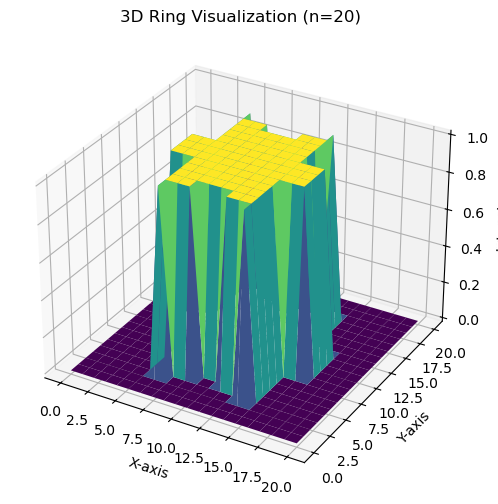

Jacobi relaxation converged in 567 iterations.


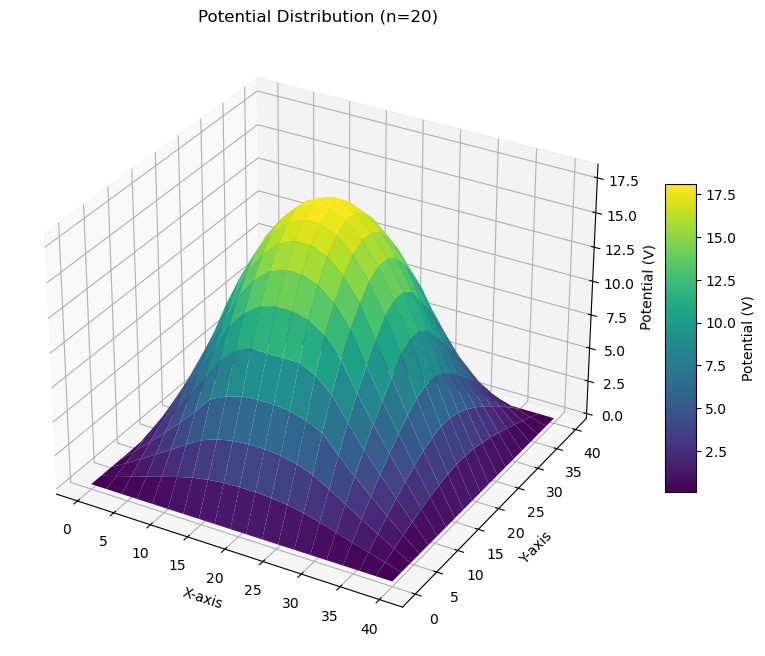

Gauss Seidel relaxation converged in 310 iterations.


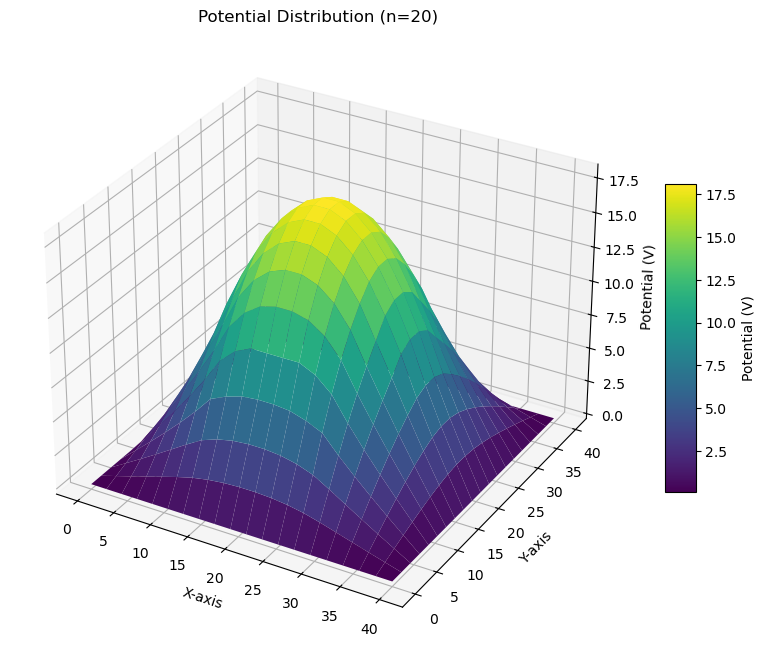

1.704088191041847
Successive Over relaxation converged in 51 iterations.


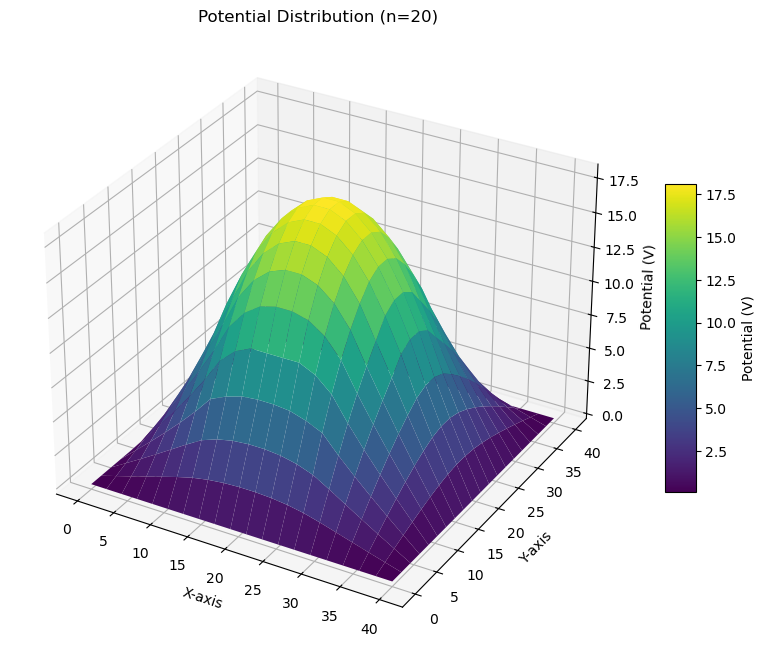


Processing n = 40


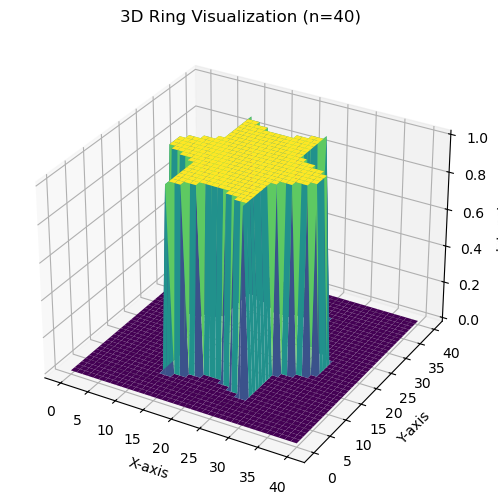

Jacobi relaxation converged in 2354 iterations.


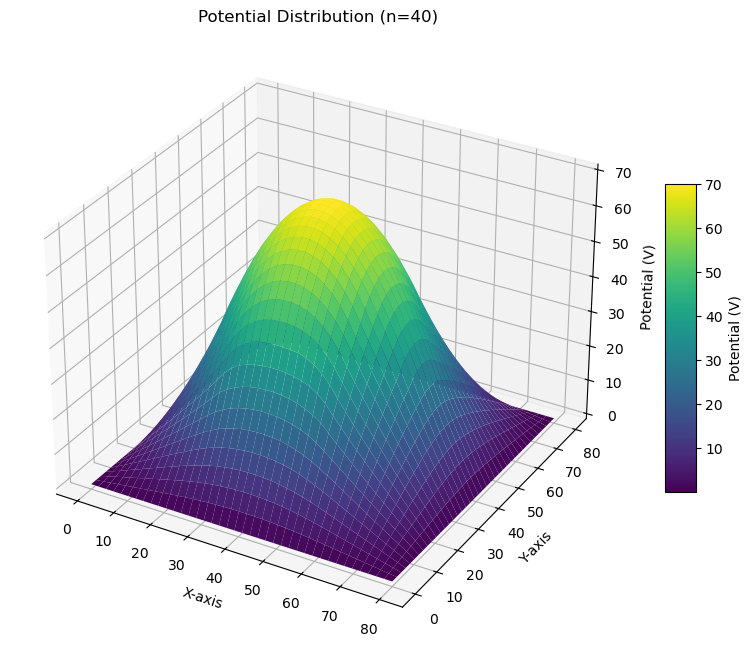

Gauss Seidel relaxation converged in 1285 iterations.


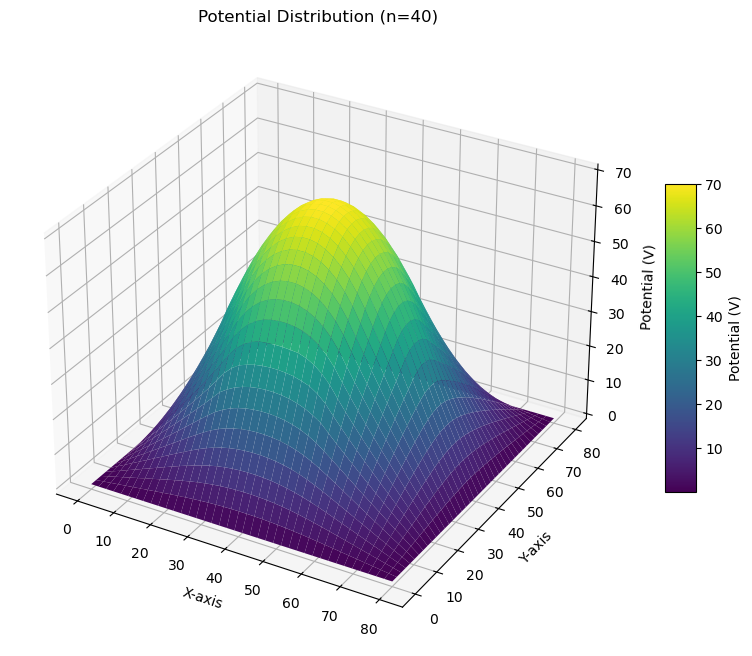

1.8474396434446976
Successive Over relaxation converged in 103 iterations.


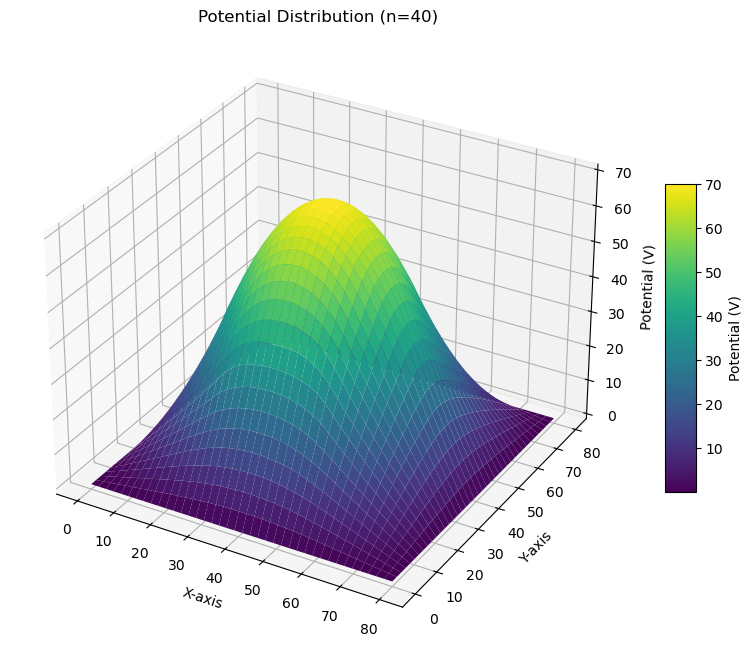


Processing n = 60


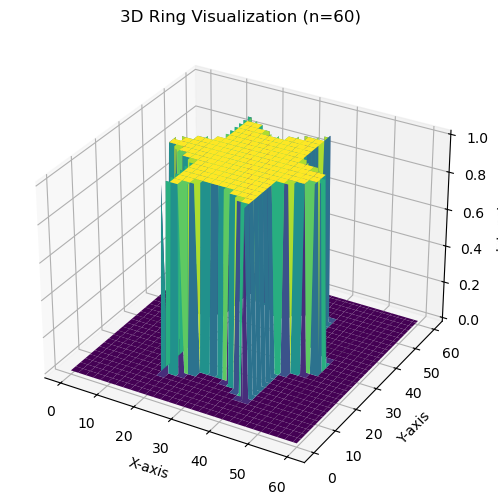

Jacobi relaxation converged in 5377 iterations.


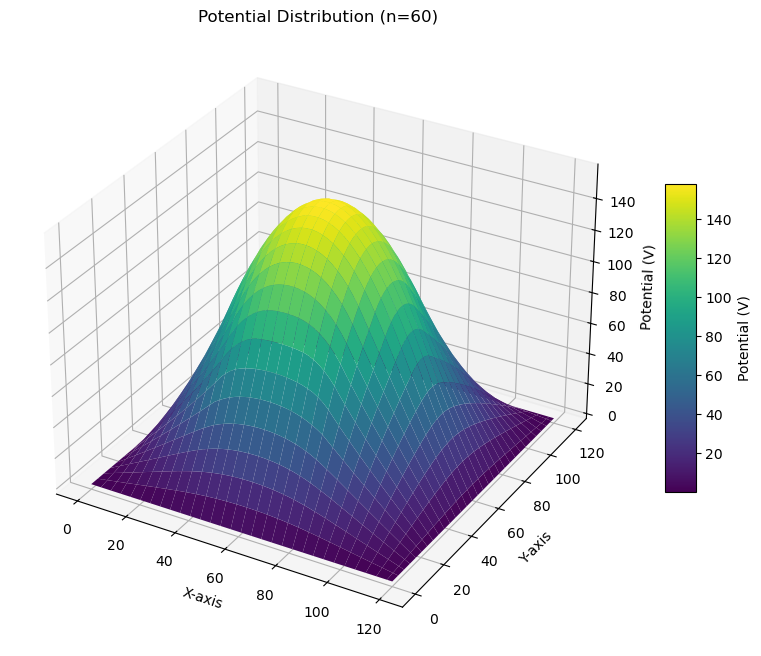

Gauss Seidel relaxation converged in 2934 iterations.


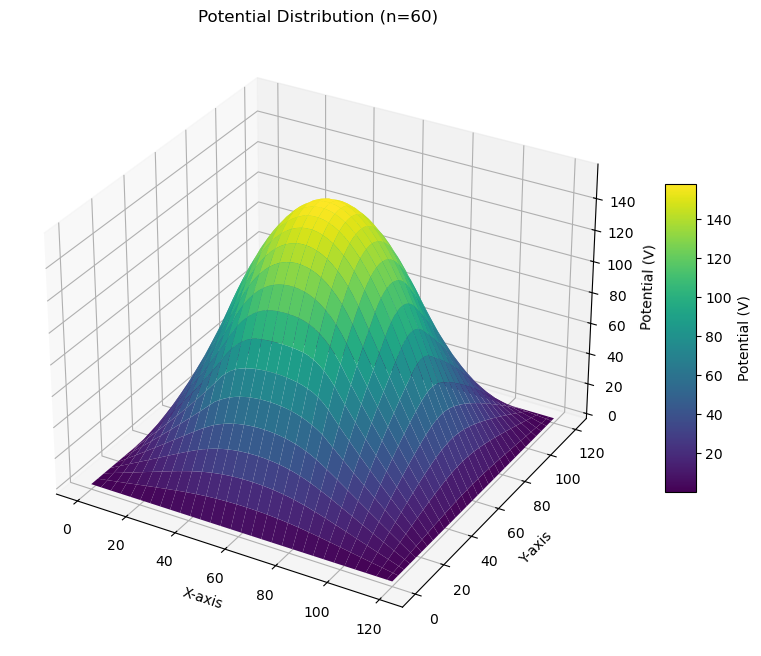

1.8972831604175024
Successive Over relaxation converged in 156 iterations.


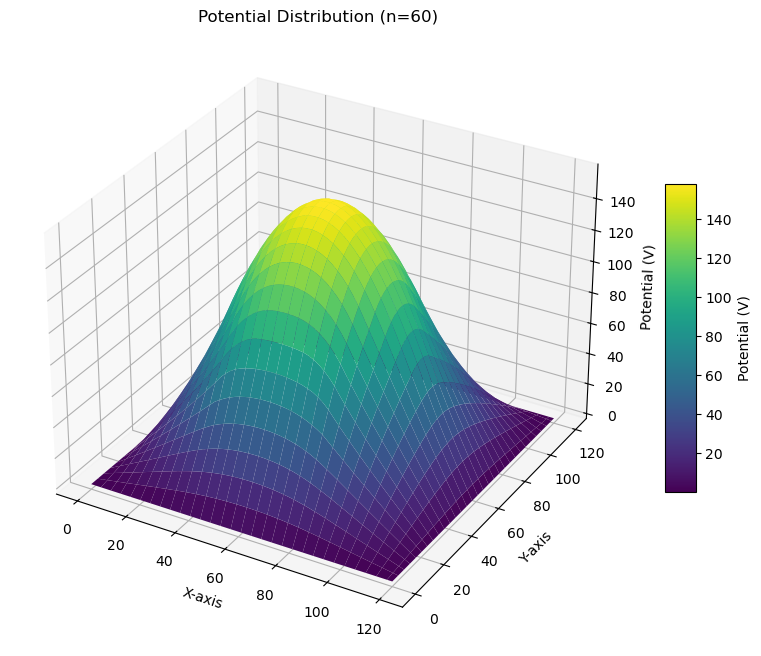

In [7]:
# this part is for Q2(b)

import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  # For 3D plotting
import copy


def ring(n):
    """
    Creates a 2D ring with ones in positions where the distance from the center
    is between n/4 and n/2.

    Parameters:
    - n: Radius parameter to define the size of the ring.

    Returns:
    - arr: 2D NumPy array representing the ring.
    """
    arr = np.zeros((2 * n + 1, 2 * n + 1))
    center = n
    for i in range(2 * n + 1):
        for j in range(2 * n + 1):
            distance = np.sqrt((i - center) ** 2 + (j - center) ** 2)
            if n / 4 < distance < n / 2:
                arr[i, j] = 1
    return arr

def star(n):
    """
    explanation of the algorithm. 
    I first plot a equilateral triangle
    The method is cut the triangle into half. the upper bound and the lower bound is calculated
    The left bound and right bound is 0.2 N and 0.8 N respectively, as the question asked the side to be 0.6N
    I use the slope to calculate the x position of one of the side of the triangle by finding the ratio 
    of the y position and the slope.
    I then use a loop to mark all the points from the x_position (x_pos) to the center (N/2) to be 1
    Since the triangle is symmetric, I can mark the other side of the triangle by mirroring the first side
    I then add the mirrored triangle to the first triangle to get the star of david
    """

    arr = np.zeros((n, n))
    center = n/2  # Center of the array

    # Define the slope for the triangle sides
    upper_bound_y = 0.5- 0.3*np.sqrt(1/3)+np.sqrt(0.6**2-0.3**2)# the upper bound of the triangle
    lower_bound_y = 0.5- 0.3*np.sqrt(1/3) # the lower bound of the triangle
    left_bound_x = 0.2 # the left bound of the triangle
    # right_bound_y = 0.8 # the right bound of the triangle, not used in the code
    slope = np.tan(np.pi/3)
    # temp = []

    for i in range(int(left_bound_x*n),int(n/2)):
        for j in range(int(lower_bound_y*n), int(upper_bound_y*n)):
            x_pos = (j/slope)
            # print(f"x_pos: {x_pos}, j: {j}")  # Debugging the x_pos calculation
            if 0 <= x_pos < n / 2:
                for k in range(int(x_pos), int(n / 2)):
                    # print(f"x_pos inside loop: {x_pos}, k: {k}")  # Debugging the inner loop
                    arr[k, j] = 1 # mark the points from x_pos to the center to be 1, the left half of the triangle
                    arr[n - 1 - k, j] = 1 # mark the mirrored points to be 1, the right half of the triangle

    arr += arr[:,::-1]    #add mirrored triangle
    arr = np.clip(arr,0,1) #cap the value to be 1 for all values greater than 1 due to the mirroring

    # for x_pos, j in temp:

    return arr

def plot_star(n):
    """
    Plots a 3D surface plot of the ring.

    Parameters:
    - n: Radius parameter used in the ring function.
    """
    fig = plt.figure(figsize=(8, 6))
    ax = fig.add_subplot(111, projection="3d")

    arr = star(n)
    x = np.linspace(0, n, n)
    y = np.linspace(0, n, n)
    X, Y = np.meshgrid(x, y)

    # Only plot points where arr==1 to highlight the ring
    ax.plot_surface(X, Y, arr, cmap="viridis")

    ax.set_title(f"3D Ring Visualization (n={n})")
    ax.set_xlabel("X-axis")
    ax.set_ylabel("Y-axis")
    ax.set_zlabel("Intensity")

    plt.show()


def jacobi_relaxation(
    charge_density, size, epsilon, bound_jr=1e-4, max_iterations=100000
):
    """
    Performs Jacobi relaxation to solve for the potential distribution.

    Parameters:
    - charge_density: 2D NumPy array representing the charge distribution.
    - size: Size of the grid (assuming square grid).
    - epsilon: Permittivity constant.
    - bound_jr: Convergence threshold.
    - max_iterations: Maximum number of iterations to prevent infinite loops.

    Returns:
    - iterations: Number of iterations performed.
    - potential_new: 2D NumPy array of the computed potential.
    """
    h = 1  # Grid spacing
    d = 2  # Number of nearest neighbors (left, right, up, down)
    iterations = 0

    # Initialize potential arrays
    potential_initial = np.zeros((size, size))
    potential_here = copy.deepcopy(potential_initial)

    while iterations < max_iterations:
        iterations += 1
        potential_new = copy.deepcopy(potential_here)

        # Update potential for each non-boundary point
        for i in range(1, size - 1):
            for j in range(1, size - 1):
                # Neighbors
                left = potential_here[i - h, j]
                right = potential_here[i + h, j]
                up = potential_here[i, j + h]
                down = potential_here[i, j - h]

                # Jacobi update formula
                potential_new[i, j] = (left + right + up + down) / (2 * d) + (
                    h**2 / (2 * d * epsilon)
                ) * charge_density[i, j]

        # Compute the maximum change across the grid
        max_delta = np.max(np.abs(potential_new - potential_here))

        # Check for convergence
        if max_delta <= bound_jr:
            break
        else:
            potential_here = potential_new.copy()

    print(potential_here)

    if iterations == max_iterations:
        print("Warning: Maximum iterations reached without convergence.")

    return iterations, potential_new


def jacobi_relaxation_vectorized(
    charge_density, size, epsilon, bound_jr=1e-4, max_iterations=100000
):
    """
    Performs Jacobi relaxation to solve for the potential distribution using vectorized operations.

    Parameters:
    - charge_density: 2D NumPy array representing the charge distribution.
    - size: Size of the grid (assuming square grid).
    - epsilon: Permittivity constant.
    - bound_jr: Convergence threshold.
    - max_iterations: Maximum number of iterations to prevent infinite loops.

    Returns:
    - iterations: Number of iterations performed.
    - potential_new: 2D NumPy array of the computed potential.
    """
    h = 1  # Grid spacing
    d = 2  # Number of nearest neighbors (left, right, up, down)
    iterations = 0

    # Initialize potential arrays
    potential_here = np.zeros((size, size))
    potential_new = np.zeros_like(potential_here)

    while iterations < max_iterations:
        iterations += 1

        # Vectorized update: Only update inner grid points
        potential_new[1:-1, 1:-1] = (
            potential_here[:-2, 1:-1]  # left
            + potential_here[2:, 1:-1]  # right
            + potential_here[1:-1, :-2]  # down
            + potential_here[1:-1, 2:]
        ) / (  # up
            2 * d
        ) + (
            h**2 / (2 * d * epsilon)
        ) * charge_density[
            1:-1, 1:-1
        ]

        # Compute the maximum change across the grid
        max_delta = np.max(np.abs(potential_new - potential_here))

        # Check for convergence
        if max_delta <= bound_jr:
            break
        else:
            # Update the potential for the next iteration
            potential_here[:, :] = potential_new[:, :]

    # print(potential_here)

    if iterations == max_iterations:
        print("Warning: Maximum iterations reached without convergence.")

    return iterations, potential_new


def Gauss_Seidel_relaxation(
    charge_density, size, epsilon, bound_gs=1e-4, max_iterations=1000000
):
    h = 1  # Grid spacing
    d = 2  # Number of nearest neighbors (left, right, up, down)
    iterations = 0

    # Initialize potential arrays
    # potential_initial = np.zeros((size, size))
    # potential_here = copy.deepcopy(potential_initial)

    # Initialize potential array
    potential_new = np.zeros((size, size))

    while True:
        iterations += 1
        max_delta = 0

        # Update potential for each non-boundary point
        for i in range(1, size - 1):
            for j in range(1, size - 1):
                # Neighbors
                left = potential_new[i - h, j]
                right = potential_new[i + h, j]
                up = potential_new[i, j + h]
                down = potential_new[i, j - h]

                # Gauss-Seidel update formula
                new_potential = (left + right + up + down) / (2 * d) + (
                    h**2 / (2 * d * epsilon)
                ) * charge_density[i, j]
                max_delta = max(max_delta, np.abs(new_potential - potential_new[i, j]))
                potential_new[i, j] = new_potential

        # Compute the maximum change across the grid

        # Check for convergence
        if max_delta <= bound_gs:
            break

    # print(potential_new)

    # if iterations == max_iterations:
    #     print("Warning: Maximum iterations reached without convergence.")

    return iterations, potential_new

# def Sucesssive_Over_relaxation(charge_density, N, epsilon, bound_here=1e-4, max_iterations=100000):
#     h = 1  # Grid spacing
#     d = 2  # Number of nearest neighbors (left, right, up, down)
#     iterations=0
#     potential_initial=np.zeros((size,size))
#     potential_new=copy.deepcopy(potential_initial)
#     rhere=np.cos(np.pi/(N-2))
#     w_opt=2/(1+np.sqrt(1-rhere**2))
#     print(w_opt)
#     while True:
#         iterations+=1
#         max_delta=0
#         for i in range(1,N-1):
#             for j in range(1,N-1): # simulate all N-2*N-2 sites using discretized poisson equation, no simulation for boundary
#                 left_index=i-h
#                 right_index=i+h
#                 up_index=j+h
#                 down_index=j-h
#                 potential_point_new=(1-w_opt)*potential_new[i,j]+w_opt*((1/(2*d))*(potential_new[i,up_index]
#                                                                                    +potential_new[i,down_index]
#                                                                                    +potential_new[right_index,j]
#                                               +potential_new[left_index,j])+(h**2/(2*d*epsilon))*charge_density[i,j]) #new point
#                 max_delta=max(max_delta,np.abs(potential_new[i,j]-potential_point_new))  #delta_phi
#                 potential_new[i,j]=potential_point_new #update point
#         if max_delta <= bound_here:
#             break
#         #print(iterations,max_delta)
#     return iterations, potential_new

def Sucesssive_Over_relaxation(charge_density, size, epsilon, bound_here=1e-4, max_iterations=100000):
    h = 1  # Grid spacing
    d = 2  # Number of nearest neighbors (left, right, up, down)
    iterations=0
    potential_initial=np.zeros((size,size))
    potential_new=copy.deepcopy(potential_initial)
    rhere=np.cos(np.pi/(size-2))
    w_opt=2/(1+np.sqrt(1-rhere**2))
    print(w_opt)
    while True:
        iterations+=1
        max_delta=0
        # Update potential for each non-boundary point
        for i in range(1, size - 1):
            for j in range(1, size - 1):
                # Neighbors
                left = potential_new[i - h, j]
                right = potential_new[i + h, j]
                up = potential_new[i, j + h]
                down = potential_new[i, j - h]

                # Gauss-Seidel update formula
                new_potential = (1-w_opt)*potential_new[i,j]+w_opt*((left + right + up + down) / (2 * d) + (
                    h**2 / (2 * d * epsilon)
                ) * charge_density[i, j])
                max_delta = max(max_delta, np.abs(new_potential - potential_new[i, j]))
                potential_new[i, j] = new_potential

        if max_delta <= bound_here:
            break
        #print(iterations,max_delta)
    return iterations, potential_new

def main():
    # Define epsilon (vacuum permittivity) - adjust units as necessary
    epsilon = 1  # F/m

    # Define the array of n values
    n_arr = [20, 40, 60]

    for n in n_arr:
        print(f"\nProcessing n = {n}")

        # Plot the 3D ring
        plot_star(n)

        # Generate the charge density using the ring function
        charge_density = star(n)
        size = n

        # Choose which Jacobi relaxation function to use:
        # Uncomment one of the following lines based on your preference

        # Option 1: Using the standard (loop-based) Jacobi relaxation
        # iterations, potential_new = jacobi_relaxation(charge_density, size, epsilon)

        # Option 2: Using the vectorized Jacobi relaxation for better performance
        iterations, potential_new = jacobi_relaxation_vectorized(charge_density, size, epsilon)


        print(f"Jacobi relaxation converged in {iterations} iterations.")

        # Plot the potential using a 3D surface plot
        fig = plt.figure(figsize=(10, 8))
        ax = fig.add_subplot(111, projection="3d")
        x = np.linspace(0, 2 * n, size)
        y = np.linspace(0, 2 * n, size)
        X, Y = np.meshgrid(x, y)

        # Plot the potential surface
        surf = ax.plot_surface(X, Y, potential_new, cmap="viridis")
        fig.colorbar(surf, ax=ax, shrink=0.5, aspect=10, label="Potential (V)")

        ax.set_title(f"Potential Distribution (n={n})")
        ax.set_xlabel("X-axis")
        ax.set_ylabel("Y-axis")
        ax.set_zlabel("Potential (V)")

        plt.show()


        # # Option 3: Using the Gauss-Seidel relaxation method
        iterations, potential_new = Gauss_Seidel_relaxation(charge_density, size, epsilon)

        print(f"Gauss Seidel relaxation converged in {iterations} iterations.")

        # Plot the potential using a 3D surface plot
        fig = plt.figure(figsize=(10, 8))
        ax = fig.add_subplot(111, projection="3d")
        x = np.linspace(0, 2 * n, size)
        y = np.linspace(0, 2 * n, size)
        X, Y = np.meshgrid(x, y)

        # Plot the potential surface
        surf = ax.plot_surface(X, Y, potential_new, cmap="viridis")
        fig.colorbar(surf, ax=ax, shrink=0.5, aspect=10, label="Potential (V)")

        ax.set_title(f"Potential Distribution (n={n})")
        ax.set_xlabel("X-axis")
        ax.set_ylabel("Y-axis")
        ax.set_zlabel("Potential (V)")

        plt.show()

        # optoins 4 : Using the Successive Over relaxation method
        iterations, potential_new = Sucesssive_Over_relaxation(charge_density, size, epsilon)

        print(f"Successive Over relaxation converged in {iterations} iterations.")

        # Plot the potential using a 3D surface plot
        fig = plt.figure(figsize=(10, 8))
        ax = fig.add_subplot(111, projection="3d")
        x = np.linspace(0, 2 * n, size)
        y = np.linspace(0, 2 * n, size)
        X, Y = np.meshgrid(x, y)

        # Plot the potential surface
        surf = ax.plot_surface(X, Y, potential_new, cmap="viridis")
        fig.colorbar(surf, ax=ax, shrink=0.5, aspect=10, label="Potential (V)")

        ax.set_title(f"Potential Distribution (n={n})")
        ax.set_xlabel("X-axis")
        ax.set_ylabel("Y-axis")
        ax.set_zlabel("Potential (V)")


        plt.show()

        # Optionally, print the potential array
        # print(f"Potential Array for n={n}:\n{potential_new}\n")


if __name__ == "__main__":
    main()

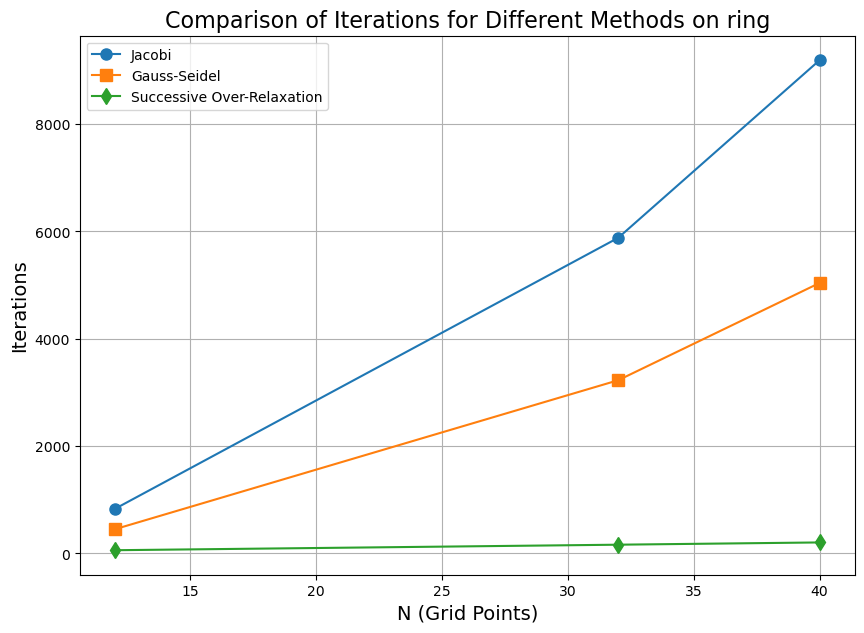

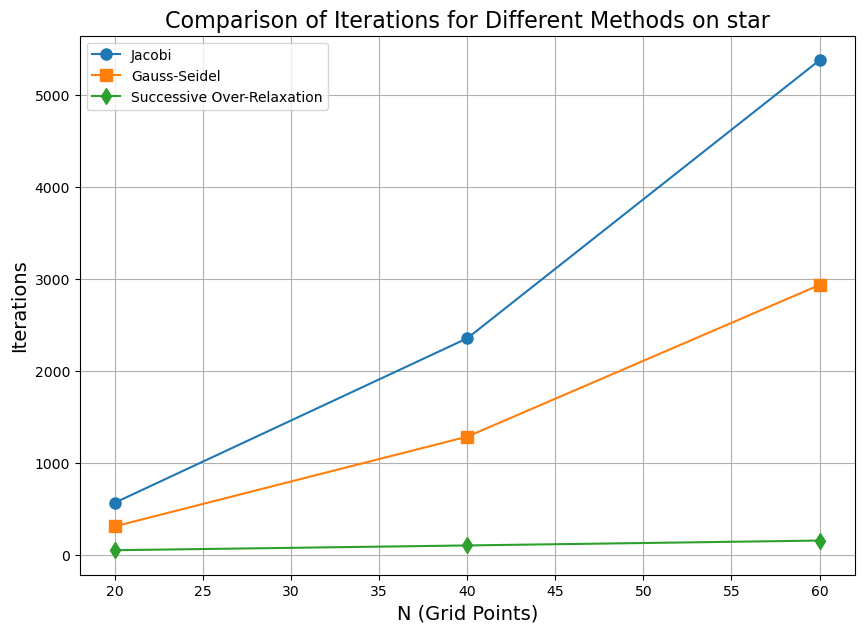

In [8]:
# perform analysis on the results
# the number of N and the iterations of three methods for the ring and star

#for ring

# Data for N and iterations
N_list = [12, 32, 40]

# Iterations for each method
jacobi_iterations = [832, 5882, 9191]
gs_iterations = [452, 3228, 5040]
sor_iterations = [60, 163, 205]

# Create a new figure for the plot
plt.figure(figsize=(10, 7))

# Plot each method with a different marker and color
plt.plot(N_list, jacobi_iterations, 'o-', label='Jacobi', markersize=8)
plt.plot(N_list, gs_iterations, 's-', label='Gauss-Seidel', markersize=8)
plt.plot(N_list, sor_iterations, 'd-', label='Successive Over-Relaxation', markersize=8)

# Add labels, title, and legend
plt.xlabel('N (Grid Points)', size=14)
plt.ylabel('Iterations', size=14)
plt.title('Comparison of Iterations for Different Methods on ring', size=16)
plt.legend()

# Show the plot
plt.grid(True)
plt.show()


# for star 

# Data for N and iterations
N_list = [20, 40, 60]

# Iterations for each method
jacobi_iterations = [569, 2357, 5382]
gs_iterations = [311, 1287, 2937]
sor_iterations = [51, 103, 156]

# Create a new figure for the plot
plt.figure(figsize=(10, 7))

# Plot each method with a different marker and color
plt.plot(N_list, jacobi_iterations, 'o-', label='Jacobi', markersize=8)
plt.plot(N_list, gs_iterations, 's-', label='Gauss-Seidel', markersize=8)
plt.plot(N_list, sor_iterations, 'd-', label='Successive Over-Relaxation', markersize=8)

# Add labels, title, and legend
plt.xlabel('N (Grid Points)', size=14)
plt.ylabel('Iterations', size=14)
plt.title('Comparison of Iterations for Different Methods on star', size=16)
plt.legend()

# Show the plot
plt.grid(True)
plt.show()


The leading coefficient of computational complexity of Jacobi's is 1/2, for Gauss-seidel, it is 1/4. for SOR, it is 1/3.
for order of the complexity. if N is the system size, Jacobi and Gauss-seidel are N^2. and SOR is N. 
From the  above, both jacobi and Gauss-seidel are increasing expotentially, with Gauss-seidel having only half of the iterations, which mean it is fast by 2 times. for SOR, we can see that it is linear. Therefore, SOR is the fastest among the three methods. Followed by Gauss-seidel and then Jacobi. This is consistent with the theoretical analysis.

### Q3
von Neumann stability analysis is to set $u(n,r)=A^ne^{ikrh}$ 
avection equation: $\frac{\partial u}{\partial t} = -c\frac{\partial u}{\partial x}$ 
our target is to check A

$\frac{u(n+1,r) - u(n,r)}{\tau} = -c\frac{u(n,r+1)-u(n,r-1)}{2h}$


$AA^ne^{ikrh} - A^ne^{ikrh} =  -\frac{c\tau}{2h}({{A^ne^{ik.(r+1)h}}-A^ne^{ik.(r-1)h}})$


$A=1-\frac{c\tau}{2h}(e^{ikh}-e^{-ikh})=1-\frac{c\tau}{h}i \sin{(kh)}$

$|A|=\sqrt{1+(\frac{c\tau}{h})^2 \sin^2{(kh)}} \gt 1$

FTCS is not stable for advection equation

\
\
\
for FTFS

$\frac{u(n+1,r) - u(n,r)}{\tau} = -c\frac{u(n,r+1)-u(n,r)}{h}$

$AA^ne^{ikrh} - A^ne^{ikrh} =  -\frac{c\tau}{h}({{A^ne^{ik.(r+1)h}}-A^ne^{ikrh}})$

$A=-\frac{c\tau}{h}(e^{ikh}-1)+1=1-\frac{2c\tau}{h}i \sin{\frac{kh}{2}}e^{ikh/2}$

$|A|=\sqrt{(1-\frac{2c\tau}{h}i \sin{\frac{kh}{2}}e^{ikh/2})(1+\frac{2c\tau}{h}i \sin{\frac{kh}{2}}e^{-ikh/2})}$

After smplyfing, we get $|A| = \sqrt{1+(\frac{4c\tau}{h}+(\frac{2c\tau}{h})^2) \sin^2{\frac{kh}{2}} }>1$

whici is not stable too

\
\
\
for CTCS

$\frac{u(n+1,r) - u(n-1,r)}{\tau} = -\frac{F(n,r+1)-F(n,r-1)}{h}$

$u(n+1,r) = u(n-1,r) - \frac{F(n,r+1)-F(n,r-1)}{h} \tau$

${u(n+1,r) - u(n-1,r)} = -\frac{c\tau}{h}({{u(n,r+1)-u(n,r-1)}})$

$AA^ne^{ikrh} - A^{n-1}e^{ikrh} =  -\frac{c\tau}{h}({{A^ne^{ik.(r+1)h}}-A^ne^{ik.(r-1)h}})$

after simplyfing, we get $A^2 = 1-2iA\frac{c\tau}{h} \sin{kh}$
\
\
rewrite the equation, we get $A^2 + 2iA\frac{c\tau}{h} \sin{kh} - 1 = 0$
\
\
$A = -i\dfrac{c\tau}{h} \sin{(kh)} \pm \sqrt{1-(\dfrac{c\tau}{h} \sin{(kh)})^2}$

which is a complex number,
\
\
 by $|a+bi|^2 = (a^2+b^2)$
\
\
$|A|^2=(\frac{c\tau}{h})^2 \sin^2{(kh)}+1-(\frac{c\tau}{h})^2 \sin^2{(kh)}=1$
\
\
$|A| = 1$

Therefore, CTCS(leapfrog) is stable for advection equation


for lax wendroff
$u(n+1,r)=u(n,r)-\tau \frac{\partial F(n,r)}{\partial x}+\frac{\tau^2}{2}(\frac{\partial}{\partial x}[F'\frac{\partial F}{\partial
x}](n,r))$

$u(n+1,r)=u(n,r)-\tau \frac{F(n,r+1)-F(n,r-1)}{2h}+\frac{\tau^2}{2}(\frac{[F'\frac{\partial F}{\partial x}](n,r+1/2)-[F'\frac{\partial F}{\partial x}](n,r-1/2)}{h})$

$=u(n,r)-\tau \frac{F(n,r+1)-F(n,r-1)}{2h}+\frac{\tau^2}{2h}(F'(n,r+1/2)\frac{F(n,r+1)-F(n,r)}{h}-F'(n,r-1/2)\frac{F(n,r)-F(n,r-1)}{h})$

where $ F'(n,r\pm 1/2)=F'(\frac{u(n,r\pm 1)+u(n,r)}{2}) =c \text{ since }F(u)=cu,F'(u)=c$

$=u(n,r)- \frac{c\tau}{2h}(u(n,r+1)-u(n,r-1))+\frac{c^2\tau^2}{2h^2}(u(n,r+1)-2u(n,r)+u(n,r-1))$

$AA^ne^{ikrh}=A^ne^{ikrh}-\frac{c\tau}{2h}(A^ne^{ik(r+1)h}-A^ne^{ik(r-1)h})+\frac{c^2\tau^2}{2h^2}(A^ne^{ik(r+1)h}-2A^ne^{ikrh}+A^ne^{ik(r-1)h})$

After simplyfing, we get $A = 1-\frac{c\tau}{h}i \sin{kh}+\frac{c^2\tau^2}{h^2}(\cos{kh}-1)$

which is a complex number,
\
\
by $|a+bi|^2 = (a^2+b^2)$

$|A|^2=1-(\frac{c\tau}{h})^2((\frac{c\tau}{h})^2-1)(\cos(kh)-1)^2$

when $c\tau/h\leq 1$ we have $|A|\leq 1$. hence lax wendroff is stable for advection equation when $c\tau/h\leq 1$



In [9]:
# Q4
from matplotlib.animation import FuncAnimation
from matplotlib import rc
from mpl_toolkits.mplot3d import Axes3D  # Required for 3D plotting


h = 1
tau = 1
c=1
L = 400
T = 300


def LaxWendroff(initial, L, T, tau, h, c):
    # Initialize a 2D array to store density values
    arr = np.zeros((int(L/h), int(T/tau)))
    
    # Set the initial condition for t=0
    arr[:, 0:1] = initial
    
    # Time-stepping loop
    for t in range(1, int(T/tau)):
        # Compute periodic boundary conditions using np.concatenate
        rho_plus = np.concatenate([arr[1:, t-1], [arr[0, t-1]]])      # ρ_{i+1}
        rho_minus = np.concatenate([[arr[-1, t-1]], arr[:-1, t-1]]) # ρ_{i-1}
        
        # First-order central difference (advection term)
        adv = (rho_plus - rho_minus) / (2 * h)
        
        # Second-order central difference (diffusion term)
        diff = (rho_plus - 2 * arr[:, t-1] + rho_minus) / (h**2)
        
        # Lax-Wendroff update
        arr[:, t] = arr[:, t-1] - c * tau * adv + (c**2 * tau**2 / 2) * diff
        
    
    return arr



def plot_3D_density(L, T, tau, h, density_array):
    """
    Plots a 3D surface of traffic density over space and time.

    Parameters:
    - L (float): Length of the spatial domain.
    - T (float): Total simulation time.
    - tau (float): Time step size.
    - h (float): Spatial step size.
    - density_array (2D numpy array): Array of density values with shape (num_space_points, num_time_steps).

    Returns:
    - None: Displays a 3D surface plot.
    """
    # Validate input dimensions
    num_space_steps, num_time_steps = density_array.shape
    expected_space_steps = int(L / h)
    expected_time_steps = int(T / tau)
    
    if num_space_steps != expected_space_steps or num_time_steps != expected_time_steps:
        raise ValueError(
            f"Shape of density_array {density_array.shape} does not match expected "
            f"dimensions ({expected_space_steps}, {expected_time_steps})."
        )
    
    # Create time and space arrays
    time = np.linspace(0, T, num_time_steps)
    space = np.linspace(0, L, num_space_steps)
    
    # Create meshgrid for plotting
    Time, Space = np.meshgrid(time, space)
    
    # Create a figure and a 3D Axes
    fig = plt.figure(figsize=(14, 8))
    ax = fig.add_subplot(111, projection='3d')
    
    # Plot the surface
    surf = ax.plot_surface(Time, Space, density_array, cmap='coolwarm', edgecolor='none', alpha=0.8)
    
    # Customize the z axis
    ax.set_zlim(np.min(density_array), np.max(density_array))
    
    # Label the axes
    ax.set_xlabel('Time', fontsize=12, labelpad=10)
    ax.set_ylabel('Space', fontsize=12, labelpad=10)
    ax.set_zlabel('Density ρ', fontsize=12, labelpad=10)
    
    # Add a color bar which maps values to colors
    fig.colorbar(surf, shrink=0.5, aspect=10, pad=0.1, label='Density ρ')
    
    # Set plot title
    ax.set_title('3D Traffic Density Over Space and Time', fontsize=15, pad=20)
    
    # Adjust the viewing angle for better visualization
    ax.view_init(elev=30, azim=135)  # You can adjust these values as needed
    
    # Show the plot
    plt.show()

        
    

(400, 1)


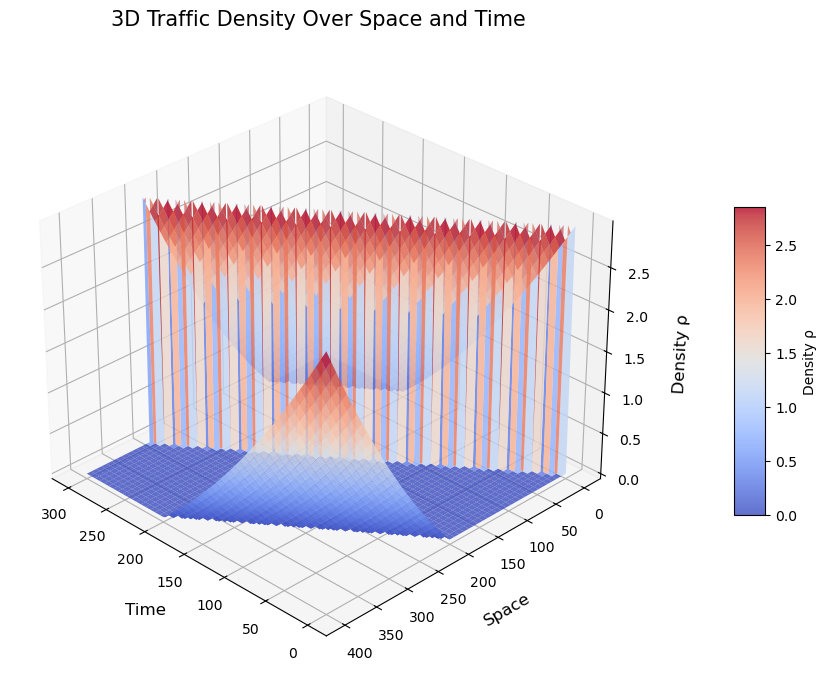

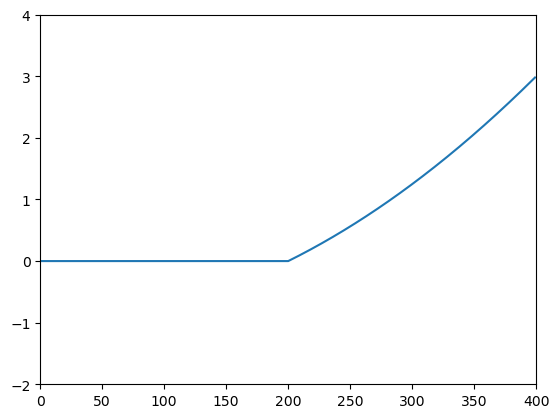

In [10]:
# (a)
rho_arr=np.zeros((int(L/h),1)) #initial rho

rho_arr[int(L/h/2):int(L/h), 0] += np.array([
    (i-L/h/2)*(i+L/h/2) * 4 / ((L/h)**2) 
    for i in range(int(L/h/2), int(L/h))
])

#print dimensions of rho_arr
print(rho_arr.shape)

arr=LaxWendroff(rho_arr,L,T,tau,h,c)

plot_3D_density(L,T,tau,h,arr)

fig,ax=plt.subplots()
xd,yd=[],[]
ln,=ax.plot([],[])
ax.set_xlim(0,L/h)
ax.set_ylim(-2,4)

def update(frame):
    xd=np.arange(L/h)
    yd=arr[:,int((frame/tau))]
    ln.set_data(xd,yd)
    return ln,

animation=FuncAnimation(fig,update,frames=T)
rc('animation',html="jshtml")
animation

(400, 1)


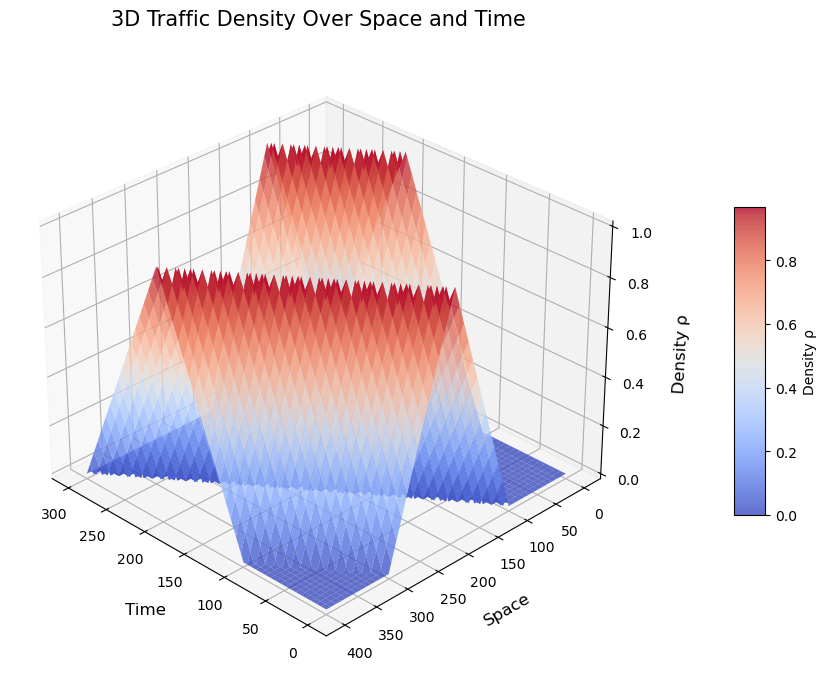

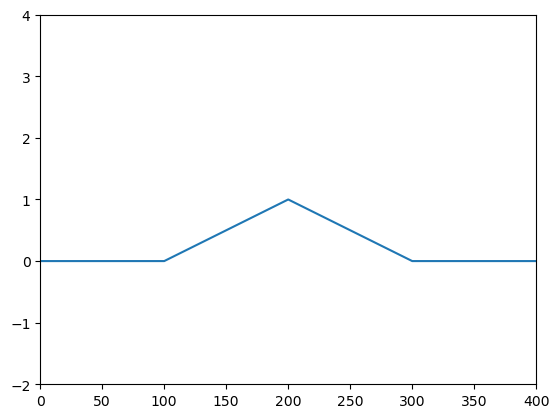

In [11]:
# (b)
rho_arr=np.zeros((int(L/h),1)) #initial rho

rho_arr[int(L/h/4):int(3*L/h/4), 0] += np.array([
    (L/h/4 - abs(i - L/h/2)) * 4 / L/h 
    for i in range(int(L/h/4), int(3*L/h/4))
])

#print dimensions of rho_arr
print(rho_arr.shape)

arr=LaxWendroff(rho_arr,L,T,tau,h,c)

plot_3D_density(L,T,tau,h,arr)

fig,ax=plt.subplots()
xd,yd=[],[]
ln,=ax.plot([],[])
ax.set_xlim(0,L/h)
ax.set_ylim(-2,4)

def update(frame):
    xd=np.arange(L/h)
    yd=arr[:,int((frame/tau))]
    ln.set_data(xd,yd)
    return ln,

animation=FuncAnimation(fig,update,frames=T)
rc('animation',html="jshtml")
animation

(400, 1)


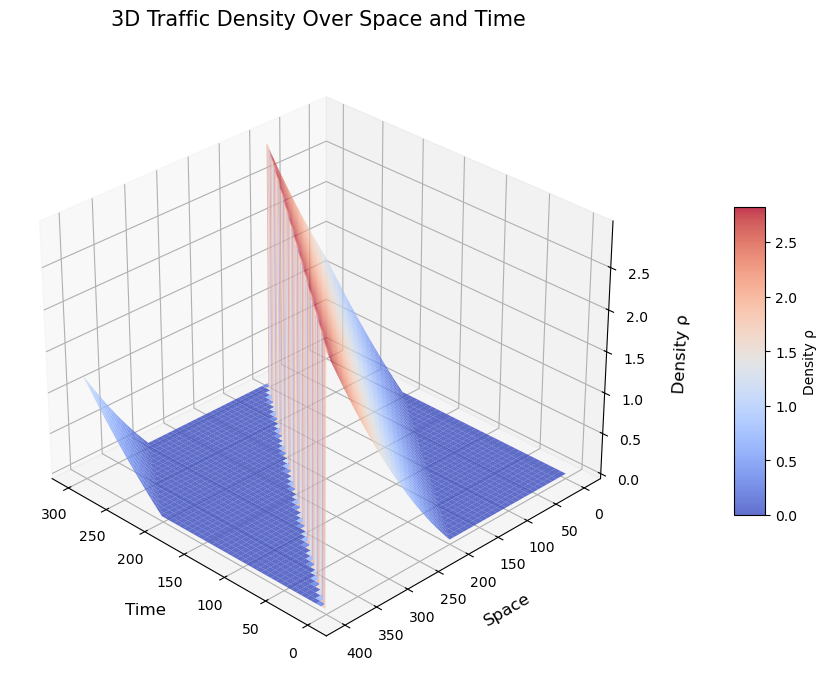

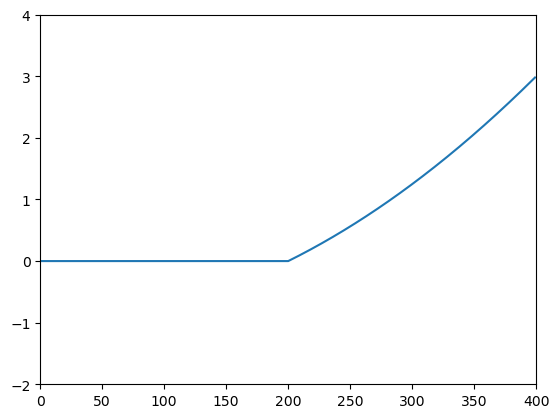

In [12]:
# (c)
c = -1
rho_arr=np.zeros((int(L/h),1)) #initial rho

rho_arr[int(L/h/2):int(L/h), 0] += np.array([
    (i-L/h/2)*(i+L/h/2) * 4 / ((L/h)**2) 
    for i in range(int(L/h/2), int(L/h))
])

#print dimensions of rho_arr
print(rho_arr.shape)

arr=LaxWendroff(rho_arr,L,T,tau,h,c)

plot_3D_density(L,T,tau,h,arr)

fig,ax=plt.subplots()
xd,yd=[],[]
ln,=ax.plot([],[])
ax.set_xlim(0,L/h)
ax.set_ylim(-2,4)

def update(frame):
    xd=np.arange(L/h)
    yd=arr[:,int((frame/tau))]
    ln.set_data(xd,yd)
    return ln,

animation=FuncAnimation(fig,update,frames=T)
rc('animation',html="jshtml")
animation